# Sistema Completo de Predicción de Contacto en Cobranzas

## Flujo del Sistema
1. **Preprocesamiento**: Carga y limpieza de datos
2. **Entrenamiento**: Múltiples modelos con diferentes configuraciones
3. **Selección**: Automática de 3 mejores modelos (Balanceado, Alto Recall, Alta Precisión)
4. **Simulación**: Evaluar cada modelo en escenario real de llamadas
5. **Comparación**: vs estrategia aleatoria
6. **Visualización**: Animaciones y gráficos comparativos

## Métricas Clave
- **Llamadas para X% de contactos**: Cuántas llamadas necesito para encontrar 50%, 80%, 95%, 100% de contactos
- **Tasa de éxito por segmento**: % de contactos en top 10%, 20%, 50% del dataset
- **Mejora vs aleatorio**: Cuántas llamadas ahorro usando el modelo

In [1]:
# Imports
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importar clases del sistema
from contact_predictor import (
    DataPreprocessor,
    ModelTrainer,
    ModelTuner,
    ContactSimulator,
    MetricsCalculator,
    get_best_models_summary
)
from contact_visualizer import (
    ContactAnimator,
    StaticVisualizer
)

%matplotlib inline

print("✓ Módulos importados correctamente")

✓ Módulos importados correctamente


## 1. Configuración y Carga de Datos

In [2]:
# CONFIGURACIÓN
ARCHIVO_DATOS = 'bd.txt'
RANDOM_STATE = 73  # ← Cambia este valor o ponlo None para aleatorio
TEST_SIZE = 0.2

print("="*80)
print("CONFIGURACIÓN DEL SISTEMA")
print("="*80)
print(f"Archivo de datos: {ARCHIVO_DATOS}")
print(f"Random state: {RANDOM_STATE}")
print(f"Test size: {TEST_SIZE*100:.0f}%")
print("="*80)

CONFIGURACIÓN DEL SISTEMA
Archivo de datos: bd.txt
Random state: 73
Test size: 20%


In [3]:
# Preprocesar datos
preprocessor = DataPreprocessor(ARCHIVO_DATOS, random_state=RANDOM_STATE)
preprocessor.load_data().preprocess().split_data(test_size=TEST_SIZE, stratify=True)

X_train, X_test, y_train, y_test = preprocessor.get_data()

print("\n✓ Datos listos para entrenamiento")

🎲 Random state: 73
🎨 Feature Engineering: ✓ Activado
📁 Cargando datos desde bd.txt...
✓ Datos cargados: (269880, 164)

🔧 Preprocesando datos...
  ✓ Eliminadas columnas: ['CODIGO', 'dfechNac', 'GRUPO_CAPITAL', 'PERIODO']
  ✓ Valores nulos manejados
  ✓ One-hot encoding aplicado a: ['GEnero', 'Estado_civil', 'FLAG_DEPENDIENTE', 'producto_cat', 'GRUPO_CANAL']

🎨 FEATURE ENGINEERING

🔧 Creando features de RATIOS...
   ✓ Creadas 16 features de ratios

🔧 Creando features de TENDENCIAS temporales...
   ✓ Creadas 5 features de tendencias

🔧 Creando features de DENSIDAD...
   ✓ Creadas 7 features de densidad

🔧 Creando features de INTERACCIONES...
   ✓ Creadas 3 features de interacciones

🔧 Creando features de AGREGACIÓN...
   ✓ Creadas 3 features de agregación

🔍 Verificando NaNs en features creadas...
   ✓ No se encontraron NaNs en features creadas

✅ Feature Engineering completado:
   • Features originales: 173
   • Features creadas: 34
   • Features finales: 207

  🔍 Analizando correlacione

## 2. Entrenamiento y Selección de Modelos

In [4]:
# Entrenar múltiples modelos
trainer = ModelTrainer(X_train, y_train, X_test, y_test, random_state=RANDOM_STATE)
trainer.train_all_models()

# Seleccionar los 3 mejores
mejores_modelos = trainer.select_best_models()


🚀 ENTRENANDO ZOO COMPLETO DE MODELOS

⚖️  APLICANDO TÉCNICAS DE BALANCEO

1. Aplicando SMOTE...
   SMOTE - Shape: (401044, 161), Distribución: {0: 200522, 1: 200522}

2. Aplicando Random Undersampling...
   Undersampling - Shape: (46146, 161), Distribución: {0: 30764, 1: 15382}

3. Aplicando SMOTETomek...
   SMOTETomek - Shape: (400984, 161), Distribución: {0: 200492, 1: 200492}

4. Aplicando ADASYN...
   ADASYN - Shape: (401962, 161), Distribución: {1: 201440, 0: 200522}

✓ Balanceo completado

📊 Zoo de modelos:
   • Total modelos: 25
   • Técnicas de balanceo: 5
   • Total combinaciones: 125

  Entrenando todas las combinaciones...

  📊 Dataset: Original
    • Linear_LogisticRegression_Original... ✓ (R: 0.643, P: 0.219, F1: 0.327)
    • Linear_LogisticRegression_L1_Original... ✓ (R: 0.644, P: 0.219, F1: 0.327)
    • Linear_RidgeClassifier_Original... ✓ (R: 0.615, P: 0.223, F1: 0.328)
    • Linear_SGDClassifier_Original... ✓ (R: 0.616, P: 0.211, F1: 0.315)
    • Linear_LinearDiscrimi

In [5]:
# Ver resumen de modelos seleccionados
df_mejores = get_best_models_summary(mejores_modelos)

print("\n" + "="*80)
print("MODELOS SELECCIONADOS")
print("="*80)
print(df_mejores.to_string(index=False))
print("="*80)


MODELOS SELECCIONADOS
       Tipo                           Nombre       Dataset  Precision   Recall  F1-Score  ROC-AUC
 Balanceado Ensemble_RandomForest_SMOTETomek    SMOTETomek   0.381711 0.404941  0.392983 0.821897
Alto_Recall  GradBoost_XGBoost_Undersampling Undersampling   0.102751 0.933420  0.185124 0.816832
Conservador GradBoost_CatBoost_Undersampling Undersampling   0.292507 0.558388  0.383907 0.829606


In [6]:
# Ver todos los resultados de entrenamiento (opcional)
df_todos = trainer.get_all_results()
print("\nTodos los modelos entrenados:")
df_todos.sort_values('f1', ascending=False)[['nombre', 'tipo_dataset', 'precision', 'recall', 'f1', 'roc_auc']]


Todos los modelos entrenados:


,nombre,tipo_dataset,precision,recall,f1,roc_auc
89,Ensemble_RandomForest_SMOTETomek,SMOTETomek,0.381711,0.404941,0.392983,0.821897
39,Ensemble_RandomForest_SMOTE,SMOTE,0.379557,0.400780,0.389880,0.822223
114,Ensemble_RandomForest_ADASYN,ADASYN,0.370631,0.410923,0.389739,0.820327
71,GradBoost_CatBoost_Undersampling,Undersampling,0.292507,0.558388,0.383907,0.829606
49,Imbalance_BalancedRandomForest_SMOTE,SMOTE,0.286362,0.541743,0.374674,0.817734
...,...,...,...,...,...,...
82,SVM_SVC_Linear_SMOTETomek,SMOTETomek,0.069195,0.930039,0.128807,0.471665
32,SVM_SVC_Linear_SMOTE,SMOTE,0.069195,0.930039,0.128807,0.471668
57,SVM_SVC_Linear_Undersampling,Undersampling,0.069524,0.831990,0.128324,0.575067
7,SVM_SVC_Linear_Original,Original,0.066724,0.921977,0.124443,0.359286


## 2.1. Hyperparameter Tuning de los Mejores Modelos

Ahora vamos a tunear los 3 mejores modelos seleccionados para intentar mejorar su desempeño.
Se realizarán **150 búsquedas aleatorias** por cada modelo (**450 en total**, toma ~10-30 minutos).

In [7]:
# Crear tuner
tuner = ModelTuner(X_train, y_train, X_test, y_test, random_state=RANDOM_STATE)

# Tunear los 3 mejores modelos (100 iteraciones cada uno)
mejores_modelos_tuned = tuner.tune_best_models(mejores_modelos, n_iter=100)

print("\n✅ Tuning completado. Los modelos ahora están optimizados.")


🔧 HYPERPARAMETER TUNING DE LOS 3 MEJORES MODELOS

📊 Configuración:
   • Modelos a tunear: 3
   • Iteraciones por modelo: 100
   • Total de combinaciones a probar: 300
   • Estrategia de tuning:
     - Balanceado: Optimiza F1-score (balance precision/recall)
     - Alto_Recall: Optimiza Recall (con precision >= 15%)
     - Conservador: Optimiza ROC-AUC (mejor discriminación)
   • Tiempo estimado: 10-30 minutos (depende del hardware)

────────────────────────────────────────────────────────────────────────────────
📌 [1/3] Tuneando: Balanceado
   Modelo original: Ensemble_RandomForest_SMOTETomek
   Métricas originales - F1: 0.3930, Recall: 0.4049, Precision: 0.3817
   🎯 Estrategia: Maximizar F1-score
────────────────────────────────────────────────────────────────────────────────

🔧 TUNING: Balanceado - Ensemble_RandomForest_SMOTETomek
📊 Configuración:
   • Iteraciones: 100
   • Cross-validation: 2 folds
   • Métrica: f1
   • Parámetros a explorar: 6

⏳ Buscando mejores hiperparámetros..

### Actualizar modelos con versiones tuneadas

Si el tuning mejoró los modelos, actualizamos `mejores_modelos` para usar las versiones tuneadas en el resto del notebook.

In [8]:
# Actualizar mejores_modelos con las versiones tuneadas
# (El resto del código usará automáticamente los modelos tuneados)
for tipo in mejores_modelos.keys():
    if tipo in mejores_modelos_tuned:
        mejores_modelos[tipo] = {
            'modelo': mejores_modelos_tuned[tipo]['modelo'],
            'info': mejores_modelos_tuned[tipo]['info']
        }

print("✅ Modelos actualizados con versiones tuneadas")
print("\nNuevas métricas después del tuning:")
for tipo, data in mejores_modelos.items():
    info = data['info']
    print(f"  • {tipo}: F1={info['f1']:.4f}, Recall={info['recall']:.4f}, Precision={info['precision']:.4f}")

✅ Modelos actualizados con versiones tuneadas

Nuevas métricas después del tuning:
  • Balanceado: F1=0.3926, Recall=0.4653, Precision=0.3395
  • Alto_Recall: F1=0.3477, Recall=0.6408, Precision=0.2385
  • Conservador: F1=0.4008, Recall=0.4874, Precision=0.3404


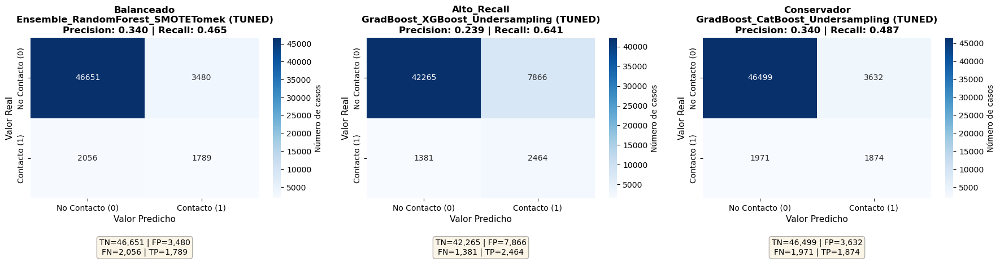


INTERPRETACIÓN DE LAS MATRICES DE CONFUSIÓN

📊 Balanceado (Ensemble_RandomForest_SMOTETomek (TUNED)):
   • Verdaderos Negativos (TN): 46,651 - No contactos correctamente identificados
   • Falsos Positivos (FP): 3,480 - Predicho contacto, pero no lo fue
   • Falsos Negativos (FN): 2,056 - Predicho no contacto, pero sí lo fue (⚠️ CRÍTICO)
   • Verdaderos Positivos (TP): 1,789 - Contactos correctamente identificados (✅ OBJETIVO)
   • Total contactos encontrados: 1789 de 3845 (46.5%)

📊 Alto_Recall (GradBoost_XGBoost_Undersampling (TUNED)):
   • Verdaderos Negativos (TN): 42,265 - No contactos correctamente identificados
   • Falsos Positivos (FP): 7,866 - Predicho contacto, pero no lo fue
   • Falsos Negativos (FN): 1,381 - Predicho no contacto, pero sí lo fue (⚠️ CRÍTICO)
   • Verdaderos Positivos (TP): 2,464 - Contactos correctamente identificados (✅ OBJETIVO)
   • Total contactos encontrados: 2464 de 3845 (64.1%)

📊 Conservador (GradBoost_CatBoost_Undersampling (TUNED)):
   • Verdade

In [9]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Crear figura con 1x3 subplots para las 3 matrices de confusión
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Iterar sobre los 3 modelos seleccionados
for i, (tipo, data) in enumerate(mejores_modelos.items()):
    # Obtener modelo y hacer predicciones
    modelo = data['modelo']
    y_pred = modelo.predict(X_test)
    
    # Calcular matriz de confusión
    cm = confusion_matrix(y_test, y_pred)
    
    # Crear heatmap
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[i],
                xticklabels=['No Contacto (0)', 'Contacto (1)'],
                yticklabels=['No Contacto (0)', 'Contacto (1)'],
                cbar_kws={'label': 'Número de casos'})
    
    # Título con información del modelo
    info = data['info']
    axes[i].set_title(f'{tipo}\n{info["nombre"]}\nPrecision: {info["precision"]:.3f} | Recall: {info["recall"]:.3f}',
                      fontsize=12, fontweight='bold')
    axes[i].set_ylabel('Valor Real', fontsize=11)
    axes[i].set_xlabel('Valor Predicho', fontsize=11)
    
    # Añadir anotaciones con métricas en la parte inferior
    tn, fp, fn, tp = cm.ravel()
    textstr = f'TN={tn:,} | FP={fp:,}\nFN={fn:,} | TP={tp:,}'
    axes[i].text(0.5, -0.25, textstr, transform=axes[i].transAxes,
                fontsize=10, ha='center', va='top',
                bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.3))

plt.tight_layout()
plt.savefig('matrices_confusion_modelos.png', dpi=150, bbox_inches='tight')
plt.show()

print("\n" + "="*80)
print("INTERPRETACIÓN DE LAS MATRICES DE CONFUSIÓN")
print("="*80)

for tipo, data in mejores_modelos.items():
    modelo = data['modelo']
    y_pred = modelo.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    tn, fp, fn, tp = cm.ravel()
    
    info = data['info']
    
    print(f"\n📊 {tipo} ({info['nombre']}):")
    print(f"   • Verdaderos Negativos (TN): {tn:,} - No contactos correctamente identificados")
    print(f"   • Falsos Positivos (FP): {fp:,} - Predicho contacto, pero no lo fue")
    print(f"   • Falsos Negativos (FN): {fn:,} - Predicho no contacto, pero sí lo fue (⚠️ CRÍTICO)")
    print(f"   • Verdaderos Positivos (TP): {tp:,} - Contactos correctamente identificados (✅ OBJETIVO)")
    print(f"   • Total contactos encontrados: {tp} de {tp+fn} ({(tp/(tp+fn)*100):.1f}%)")

print("\n" + "="*80)
print("✓ Matrices exportadas a: matrices_confusion_modelos.png")
print("="*80)

## 2.1. Matrices de Confusión de los Modelos Seleccionados

Veamos las matrices de confusión para los 3 modelos seleccionados.

## 3. Simulación de Llamadas en Escenario Real

Ahora vamos a simular cómo funcionaría cada modelo en la **realidad**:
- Ordenamos los intentos por probabilidad de contacto
- Empezamos a "llamar" en ese orden
- Medimos cuántas llamadas necesitamos para encontrar X% de contactos
- Comparamos con estrategia aleatoria (baseline)

In [10]:
# Preparar diccionario de modelos para simulación
modelos_para_simular = {
    tipo: data['modelo']
    for tipo, data in mejores_modelos.items()
}

print(f"Modelos a simular: {list(modelos_para_simular.keys())}")

Modelos a simular: ['Balanceado', 'Alto_Recall', 'Conservador']


In [11]:
# Ejecutar simulación
simulator = ContactSimulator(X_test, y_test, random_state=RANDOM_STATE)
resultados_simulacion = simulator.comparar_estrategias(modelos_para_simular)


📊 Configuración de simulación:
  Total intentos: 53,976
  Total contactos reales: 3,845 (7.12%)

🎮 SIMULANDO ESTRATEGIAS DE LLAMADAS

  📌 Simulando: Criterio_Empresarial (Capital→Edad→Dependiente)... ✓
  📌 Simulando: Aleatorio (Baseline)... ✓
  📌 Simulando: Balanceado... ✓
  📌 Simulando: Alto_Recall... ✓
  📌 Simulando: Conservador... ✓

📊 RESULTADOS: Llamadas necesarias para encontrar X% de contactos

Estrategia                | 50%          | 80%          | 95%          | 99%          | 100%        
---------------------------------------------------------------------------------------------------------
Criterio_Empresarial      | 26,933.0 (49.9%) | 41,780.0 (77.4%) | 50,873.0 (94.3%) | 53,304.0 (98.8%) | 53,965.0 (100.0%)
Aleatorio                 | 26,807.0 (49.7%) | 42,562.0 (78.9%) | 51,186.0 (94.8%) | 53,450.0 (99.0%) | 53,969.0 (100.0%)
Balanceado                | 5,955.0 (11.0%) | 19,312.0 (35.8%) | 35,356.0 (65.5%) | 47,844.0 (88.6%) | 53,710.0 (99.5%)
Alto_Recall            

## 4. Análisis de Métricas de Negocio

In [12]:
# Calcular métricas de negocio
total_contactos = y_test.sum()
df_metricas_negocio = MetricsCalculator.calcular_metricas_negocio(
    resultados_simulacion, 
    total_contactos
)


💼 MÉTRICAS DE NEGOCIO

          Estrategia  Llamadas_para_80%  Llamadas_para_100%  Llamadas_por_contacto_80%  Llamadas_por_contacto_100%  Tasa_exito_top10%  Tasa_exito_top20%  Dataset_usado_80%  Dataset_usado_100%
Criterio_Empresarial            41780.0             53965.0                  13.582575                   14.035111           6.874189           6.855025          77.404772           99.979621
           Aleatorio            42562.0             53969.0                  13.836801                   14.036151           6.744488           6.873553          78.853565           99.987031
          Balanceado            19312.0             53710.0                   6.278283                   13.968791          33.518621          23.038444          35.778865           99.507188
         Alto_Recall            19064.0             53616.0                   6.197659                   13.944343          33.981842          23.158870          35.319401           99.333037
         Conserv

In [13]:
# Exportar métricas
df_metricas_negocio.to_excel('metricas_negocio_sistema_completo.xlsx', index=False)
print("\n✓ Métricas exportadas a: metricas_negocio_sistema_completo.xlsx")


✓ Métricas exportadas a: metricas_negocio_sistema_completo.xlsx


## 5. Visualizaciones Estáticas


📊 Generando gráficos comparativos...
✓ Gráfico guardado como 'comparacion_estrategias.png'


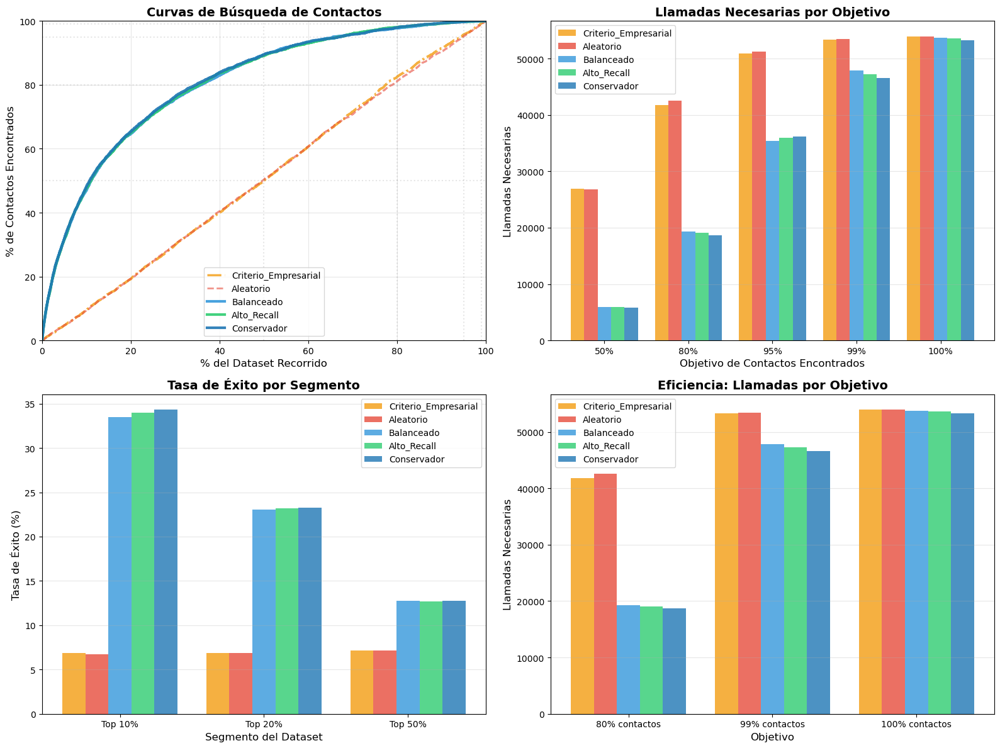

✓ Gráficos generados


In [14]:
# Gráficos comparativos
StaticVisualizer.plot_curvas_comparativas(resultados_simulacion, guardar=True)


📈 Generando análisis de mejora vs Aleatorio...


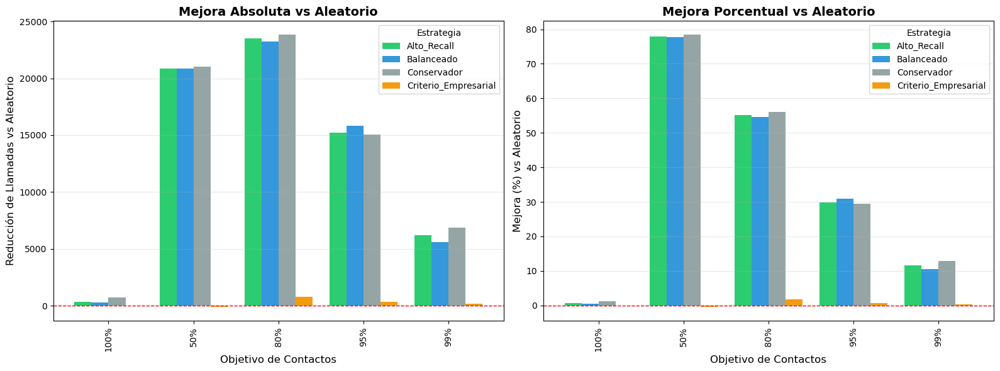

✓ Análisis de mejora generado

✓ Análisis de mejora exportado a: mejora_vs_aleatorio.xlsx


In [15]:
# Análisis de mejora vs aleatorio
df_mejora = StaticVisualizer.plot_mejora_vs_aleatorio(resultados_simulacion)

# Exportar
if df_mejora is not None:
    df_mejora.to_excel('mejora_vs_aleatorio.xlsx', index=False)
    print("\n✓ Análisis de mejora exportado a: mejora_vs_aleatorio.xlsx")

## 6. Animación Comparativa

Esta animación muestra visualmente cómo cada estrategia va encontrando contactos en tiempo real.


🎬 Creando animación comparativa...
  💾 Guardando animación como simulacion_llamadas.gif...
  ✓ Animación guardada
✓ Animación creada


Animation size has reached 20983483 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


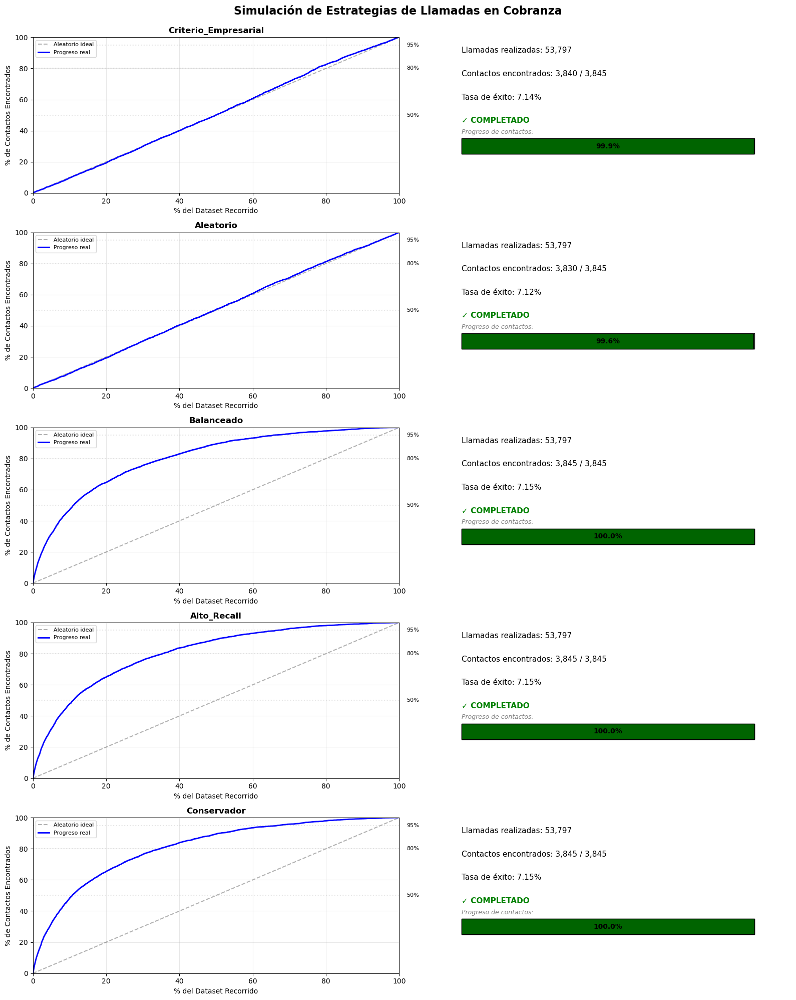

In [16]:
# Crear animación
animator = ContactAnimator(
    resultados_simulacion, 
    fps=20,  # Frames por segundo
    duracion_segundos=15  # Duración total
)

# Crear y mostrar animación
# Nota: Puede tardar unos segundos en generarse
anim = animator.crear_animacion_comparativa(guardar_como='simulacion_llamadas.gif')

# Mostrar en notebook
from IPython.display import HTML
HTML(anim.to_jshtml())

## 7. Análisis Detallado por Estrategia

Veamos en detalle cada estrategia seleccionada.

In [17]:
# Función para análisis detallado
def analizar_estrategia(nombre, resultado, aleatorio_resultado):
    print("\n" + "="*80)
    print(f"ANÁLISIS DETALLADO: {nombre}")
    print("="*80)
    
    hitos = resultado['hitos']
    hitos_aleatorio = aleatorio_resultado['hitos']
    
    print("\n📊 Desempeño por Objetivo:\n")
    
    for hito in [50, 80, 95, 100]:
        llamadas = hitos[hito]['llamadas']
        pct_dataset = hitos[hito]['porcentaje_dataset']
        
        llamadas_alea = hitos_aleatorio[hito]['llamadas']
        ahorro = llamadas_alea - llamadas
        pct_ahorro = (ahorro / llamadas_alea) * 100
        
        print(f"  {hito}% de contactos:")
        print(f"    • Llamadas necesarias: {llamadas:,}")
        print(f"    • Porcentaje del dataset: {pct_dataset:.1f}%")
        print(f"    • Ahorro vs aleatorio: {ahorro:,} llamadas ({pct_ahorro:+.1f}%)")
        print()
    
    print("\n🎯 Tasa de Éxito por Segmento:\n")
    print(f"  • Top 10%: {resultado['tasa_top_10']:.2f}% de contactos")
    print(f"  • Top 20%: {resultado['tasa_top_20']:.2f}% de contactos")
    print(f"  • Top 50%: {resultado['tasa_top_50']:.2f}% de contactos")
    
    # Interpretación de negocio
    llamadas_80 = hitos[80]['llamadas']
    contactos_80 = int(total_contactos * 0.80)
    llamadas_por_contacto = llamadas_80 / contactos_80
    
    print("\n💼 Interpretación de Negocio (Objetivo 80%):")
    print(f"  • Para encontrar {contactos_80:,} contactos (80%), necesitas hacer {llamadas_80:,} llamadas")
    print(f"  • Ratio: {llamadas_por_contacto:.2f} llamadas por contacto")
    print(f"  • Cada 100 llamadas, ~{100/llamadas_por_contacto:.1f} serán exitosas")
    
    if ahorro > 0:
        print(f"  • Ahorras {ahorro:,} llamadas vs aleatorio ({pct_ahorro:.1f}%)")
    
    print("="*80)

In [18]:
# Analizar cada estrategia vs aleatorio
aleatorio_resultado = resultados_simulacion['Aleatorio']

for nombre, resultado in resultados_simulacion.items():
    if nombre != 'Aleatorio':
        analizar_estrategia(nombre, resultado, aleatorio_resultado)


ANÁLISIS DETALLADO: Criterio_Empresarial

📊 Desempeño por Objetivo:

  50% de contactos:
    • Llamadas necesarias: 26,933.0
    • Porcentaje del dataset: 49.9%
    • Ahorro vs aleatorio: -126.0 llamadas (-0.5%)

  80% de contactos:
    • Llamadas necesarias: 41,780.0
    • Porcentaje del dataset: 77.4%
    • Ahorro vs aleatorio: 782.0 llamadas (+1.8%)

  95% de contactos:
    • Llamadas necesarias: 50,873.0
    • Porcentaje del dataset: 94.3%
    • Ahorro vs aleatorio: 313.0 llamadas (+0.6%)

  100% de contactos:
    • Llamadas necesarias: 53,965.0
    • Porcentaje del dataset: 100.0%
    • Ahorro vs aleatorio: 4.0 llamadas (+0.0%)


🎯 Tasa de Éxito por Segmento:

  • Top 10%: 6.87% de contactos
  • Top 20%: 6.86% de contactos
  • Top 50%: 7.13% de contactos

💼 Interpretación de Negocio (Objetivo 80%):
  • Para encontrar 3,076 contactos (80%), necesitas hacer 41,780.0 llamadas
  • Ratio: 13.58 llamadas por contacto
  • Cada 100 llamadas, ~7.4 serán exitosas
  • Ahorras 4.0 llamadas v

## 8. Recomendación Final y Conclusiones

In [19]:
print("="*80)
print("RECOMENDACIÓN FINAL")
print("="*80)

# Encontrar mejor estrategia para 80% (objetivo más realista)
mejor_80 = None
min_llamadas_80 = float('inf')

for nombre, resultado in resultados_simulacion.items():
    if nombre != 'Aleatorio':
        llamadas = resultado['hitos'][80]['llamadas']
        if llamadas < min_llamadas_80:
            min_llamadas_80 = llamadas
            mejor_80 = nombre

print(f"\n🏆 MODELO RECOMENDADO: {mejor_80}")
print(f"\nRazones:")
print(f"  ✓ Encuentra el 80% de contactos con menos llamadas ({min_llamadas_80:,})")

# Obtener info del modelo
for tipo, data in mejores_modelos.items():
    if tipo == mejor_80:
        info = data['info']
        print(f"  ✓ Configuración: {info['nombre']} ({info['tipo_dataset']})")
        print(f"  ✓ Métricas: Precision={info['precision']:.3f}, Recall={info['recall']:.3f}, F1={info['f1']:.3f}")
        break

resultado_mejor = resultados_simulacion[mejor_80]
resultado_aleatorio = resultados_simulacion['Aleatorio']

ahorro_80 = resultado_aleatorio['hitos'][80]['llamadas'] - resultado_mejor['hitos'][80]['llamadas']
pct_ahorro = (ahorro_80 / resultado_aleatorio['hitos'][80]['llamadas']) * 100

print(f"\n💰 Beneficio vs Aleatorio:")
print(f"  • Ahorro de {ahorro_80:,} llamadas ({pct_ahorro:+.1f}%)")
print(f"  • Tasa de éxito en Top 10%: {resultado_mejor['tasa_top_10']:.2f}% (vs {resultado_aleatorio['tasa_top_10']:.2f}%)")

print("\n📋 Modelos Disponibles:")
for tipo in ['Balanceado', 'Alto_Recall', 'Alta_Precision']:
    if tipo in modelos_para_simular:
        resultado = resultados_simulacion[tipo]
        llamadas = resultado['hitos'][80]['llamadas']
        tasa = resultado['tasa_top_10']
        print(f"  • {tipo}: {llamadas:,} llamadas para 80%, Tasa Top10%: {tasa:.2f}%")

print("\n✅ CONCLUSIÓN: El sistema es funcional y viable para producción.")
print("="*80)

RECOMENDACIÓN FINAL

🏆 MODELO RECOMENDADO: Conservador

Razones:
  ✓ Encuentra el 80% de contactos con menos llamadas (18,708.0)
  ✓ Configuración: GradBoost_CatBoost_Undersampling (TUNED) (Undersampling)
  ✓ Métricas: Precision=0.340, Recall=0.487, F1=0.401

💰 Beneficio vs Aleatorio:
  • Ahorro de 23,854.0 llamadas (+56.0%)
  • Tasa de éxito en Top 10%: 34.33% (vs 6.74%)

📋 Modelos Disponibles:
  • Balanceado: 19,312.0 llamadas para 80%, Tasa Top10%: 33.52%
  • Alto_Recall: 19,064.0 llamadas para 80%, Tasa Top10%: 33.98%

✅ CONCLUSIÓN: El sistema es funcional y viable para producción.


## 9. Exportar Modelos y Resultados Finales

In [20]:
import pickle

# Guardar modelos entrenados
for tipo, data in mejores_modelos.items():
    filename = f'modelo_{tipo.lower()}.pkl'
    with open(filename, 'wb') as f:
        pickle.dump(data['modelo'], f)
    print(f"✓ {tipo} guardado en {filename}")

# Guardar preprocessor (para usar en producción)
with open('preprocessor.pkl', 'wb') as f:
    pickle.dump(preprocessor, f)
print("✓ Preprocessor guardado en preprocessor.pkl")

print("\n✅ Sistema completo exportado y listo para uso")

✓ Balanceado guardado en modelo_balanceado.pkl
✓ Alto_Recall guardado en modelo_alto_recall.pkl
✓ Conservador guardado en modelo_conservador.pkl
✓ Preprocessor guardado en preprocessor.pkl

✅ Sistema completo exportado y listo para uso


## 10. Próximos Pasos

### Feature Engineering
- Crear ratios: gestiones_efectivas / gestiones_totales
- Tendencias: incremento/decremento entre periodos
- Interacciones: edad × dias_mora, producto × canal
- Agregaciones: total_gestiones_all_channels

### Optimización de Hiperparámetros
- Grid Search / Random Search
- Bayesian Optimization
- Cross-validation con métrica F1 o Recall

### Validación
- Si hay datos de otros periodos, validar temporalmente
- A/B testing en producción
- Monitoreo de performance

### Deployment
- API REST para predicciones
- Pipeline de actualización periódica
- Dashboard de monitoreo